<a href="https://colab.research.google.com/github/AarnoStormborn/Python-opencv-DeepLearning-for-CV/blob/main/CV02_Image_Processing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Image Processing

In [1]:
import cv2
import matplotlib.pyplot as plt

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


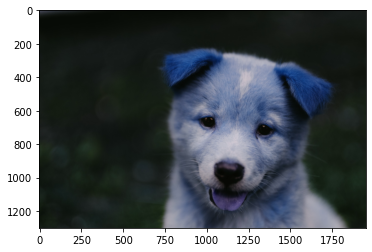

In [3]:
img = cv2.imread("/content/drive/MyDrive/udemy/Computer-Vision-with-Python/DATA/00-puppy.jpg")
plt.imshow(img)

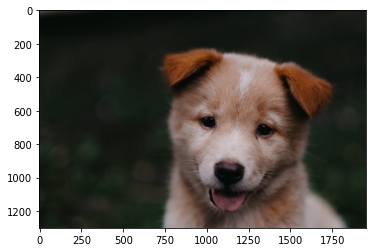

In [4]:
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)

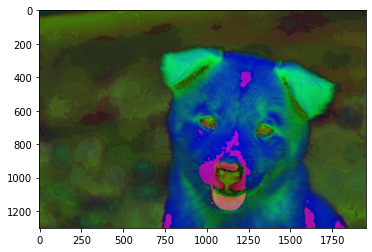

In [5]:
img = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
plt.imshow(img)

### blending images

In [6]:
img1 = cv2.imread('/content/drive/MyDrive/udemy/Computer-Vision-with-Python/DATA/dog_backpack.png')
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)

img2 = cv2.imread('/content/drive/MyDrive/udemy/Computer-Vision-with-Python/DATA/watermark_no_copy.png')
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

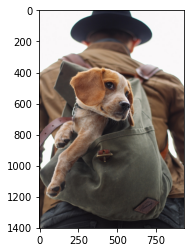

In [7]:
plt.imshow(img1)

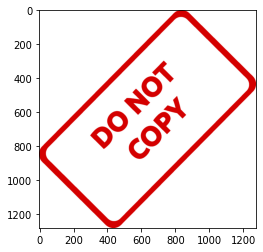

In [8]:
plt.imshow(img2)

In [9]:
img1.shape, img2.shape

((1401, 934, 3), (1280, 1277, 3))

In [10]:
# resize
img1 = cv2.resize(img1, (1200,1200))
img2 = cv2.resize(img2, (1200,1200))

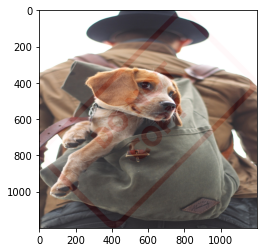

In [11]:
blended = cv2.addWeighted(src1=img1, alpha=1, src2=img2, beta=0.1, gamma=0.1) # Works with images of same size only
plt.imshow(blended)

### Image Thresholding

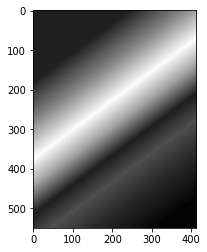

In [12]:
img = cv2.imread('/content/drive/MyDrive/udemy/Computer-Vision-with-Python/DATA/rainbow.jpg',0) # second param 0 makes image grayscale
plt.imshow(img, cmap='gray')

In [13]:
ret1, thresh1 = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY_INV)

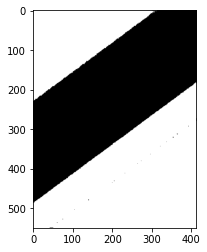

In [14]:
plt.imshow(thresh1, cmap='gray')

`cv2.THRESH_TOZERO`

Everything over the threshold, brought to the threshold value, others to zero

In [15]:
ret2, thresh2 = cv2.threshold(img, 127, 255, cv2.THRESH_TOZERO)

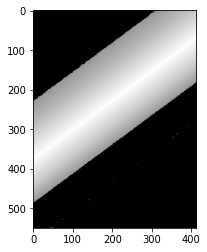

In [16]:
plt.imshow(thresh2, cmap='gray')

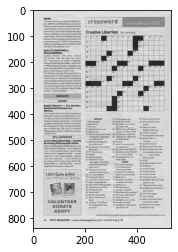

In [17]:
# A real use case

img = cv2.imread('/content/drive/MyDrive/udemy/Computer-Vision-with-Python/DATA/crossword.jpg',0)
plt.imshow(img, cmap='gray')

In [18]:
def show_pic(img):

    plt.figure(figsize=(15,15))
    plt.imshow(img,cmap='gray')

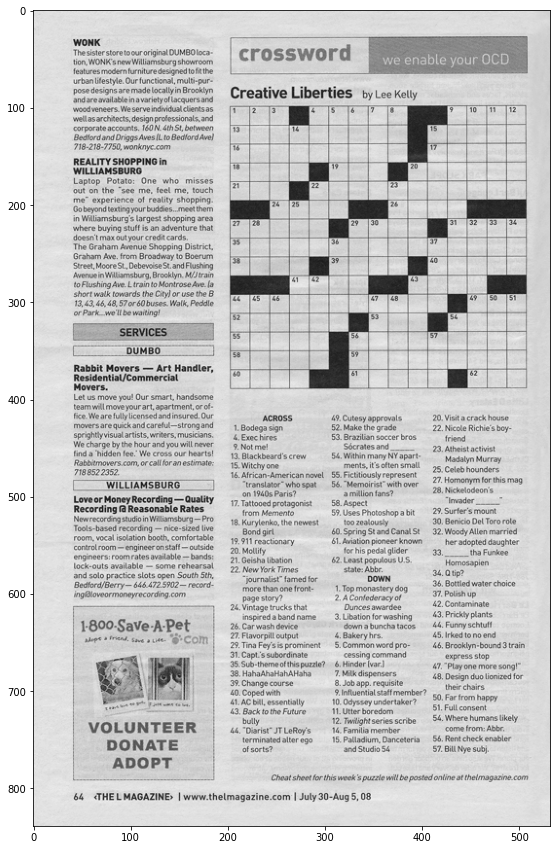

In [19]:
show_pic(img)

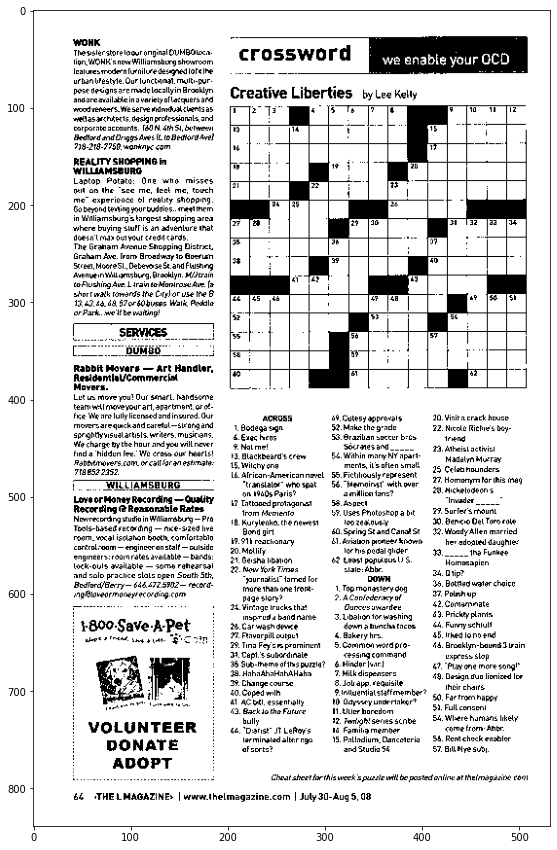

In [20]:
ret, th1 = cv2.threshold(img, 150, 255, cv2.THRESH_BINARY)
show_pic(th1)

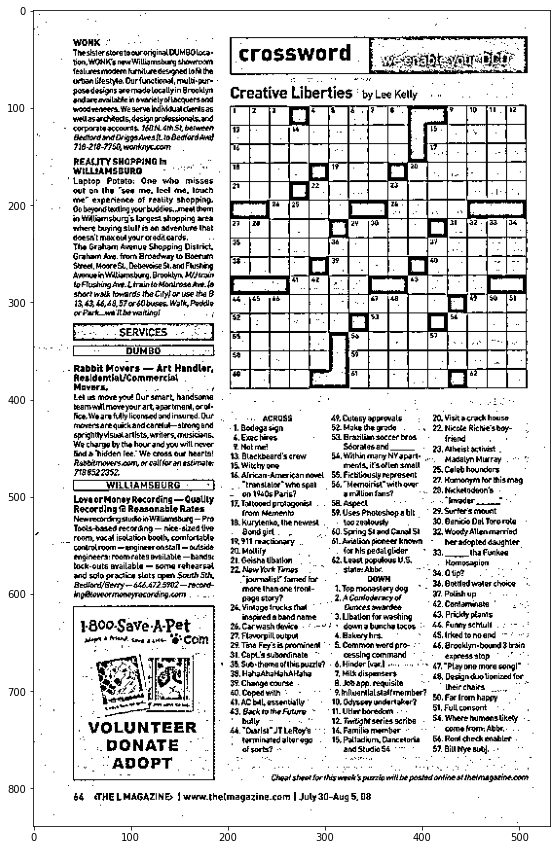

In [21]:
# Adaptive Threshold

th2 = cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 9,10)
show_pic(th2)

### Blurring and Smoothing

Blurring and Smoothing are important concepts for object detection.  
Edge detection is crucial to classify objects

Methods:
* Gamma Correction

In [22]:
import numpy as np

In [23]:
def load_img():
    img = cv2.imread('/content/drive/MyDrive/udemy/Computer-Vision-with-Python/DATA/bricks.jpg').astype(np.float32) / 255
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return img

In [24]:
img = load_img()

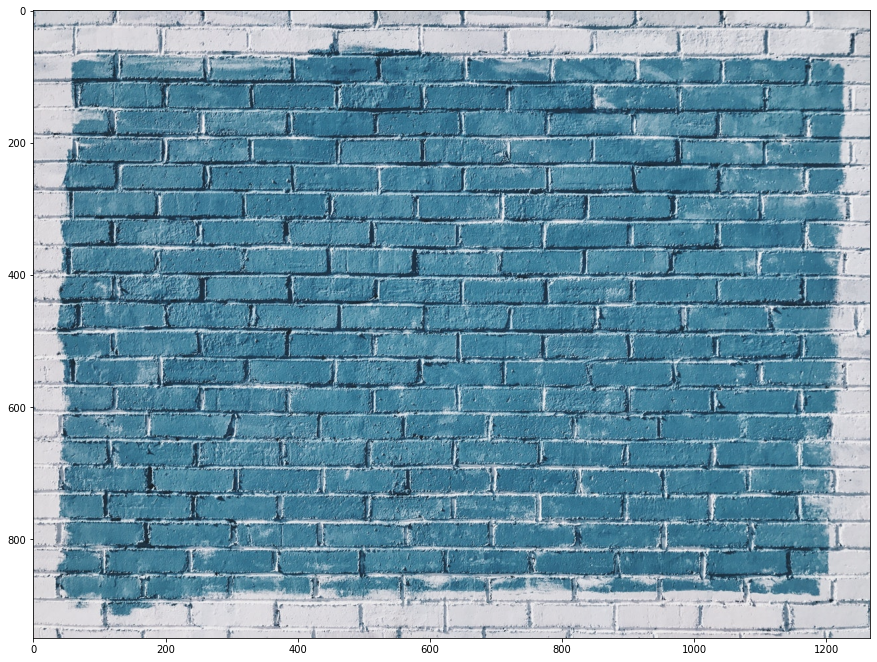

In [25]:
show_pic(img)

#### Gamma Correction

Control Brightness and Contrast of images
* Gamma < 1 => Image will be **Brigther**
* Gamma > 1 => Image will be **Darker** 

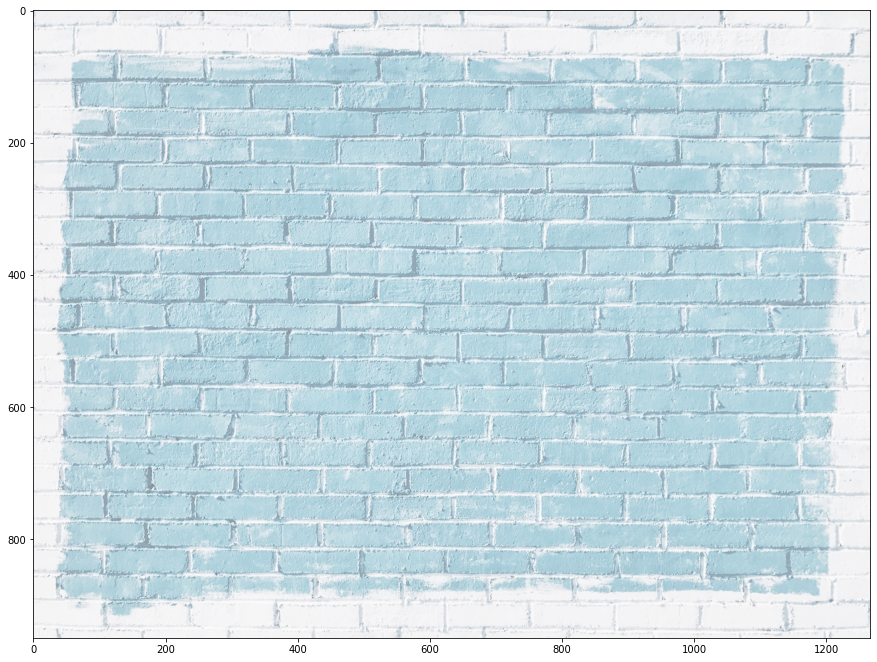

In [26]:
gamma = 1/4
res = np.power(img, gamma)
show_pic(res)

In [27]:
def add_text():
    img = load_img()
    font = cv2.FONT_HERSHEY_COMPLEX
    cv2.putText(img, text='bricks',org=(10,600),fontFace=font,fontScale=10,color=(255,0,0), thickness=4)
    return img

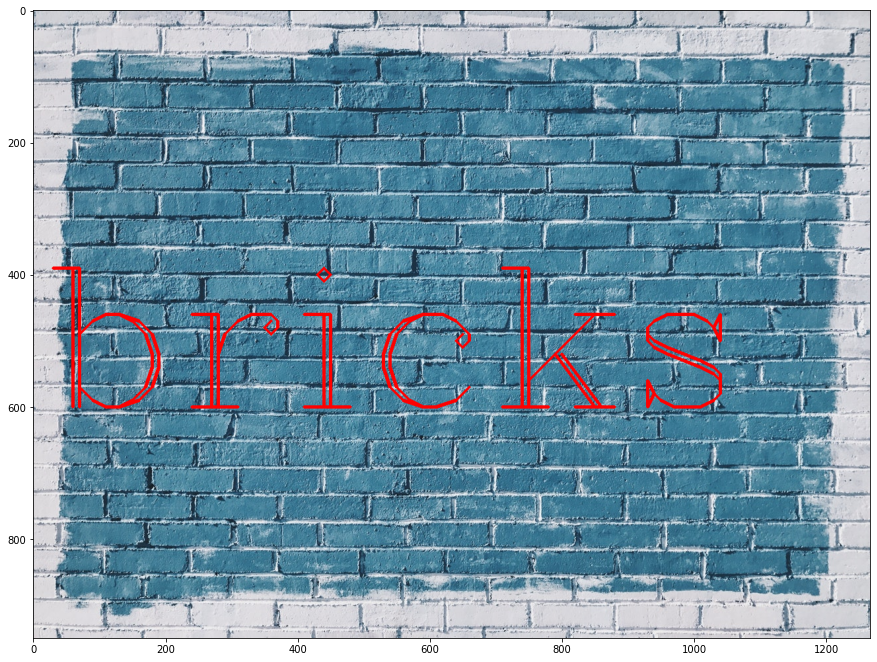

In [28]:
img = add_text()
show_pic(img)

In [29]:
kernel = np.ones(shape=(5,5), dtype=np.float32)/100
kernel

array([[0.01, 0.01, 0.01, 0.01, 0.01],
       [0.01, 0.01, 0.01, 0.01, 0.01],
       [0.01, 0.01, 0.01, 0.01, 0.01],
       [0.01, 0.01, 0.01, 0.01, 0.01],
       [0.01, 0.01, 0.01, 0.01, 0.01]], dtype=float32)

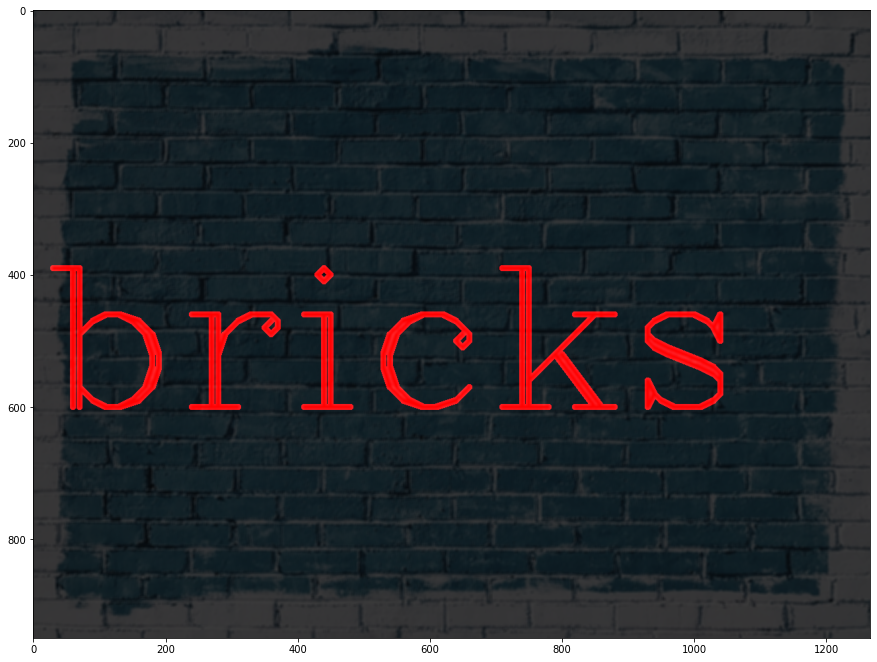

In [30]:
dst = cv2.filter2D(img, -1, kernel)
show_pic(dst)

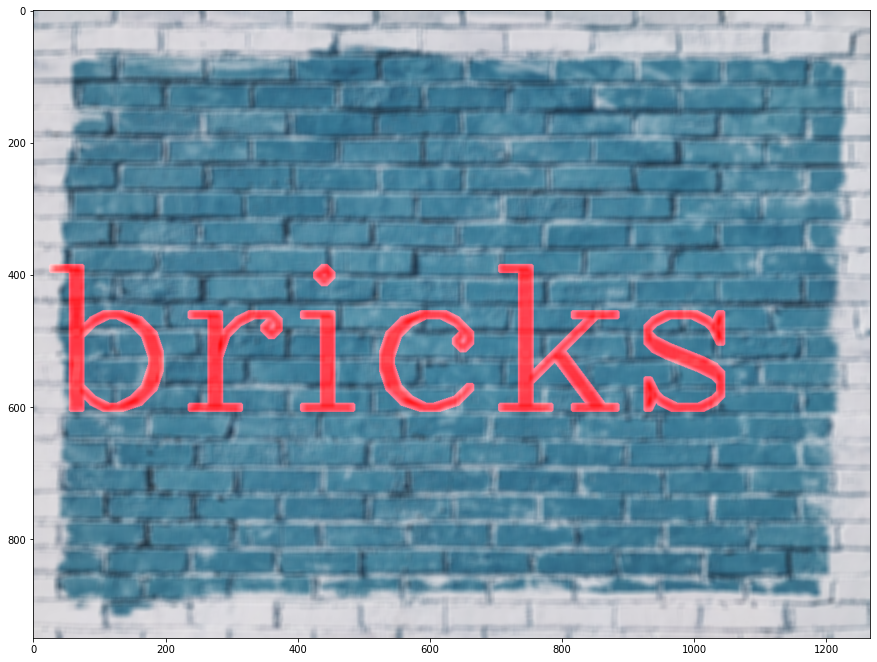

In [31]:
img = add_text()
blur = cv2.blur(img,ksize=(10,10))
show_pic(blur)

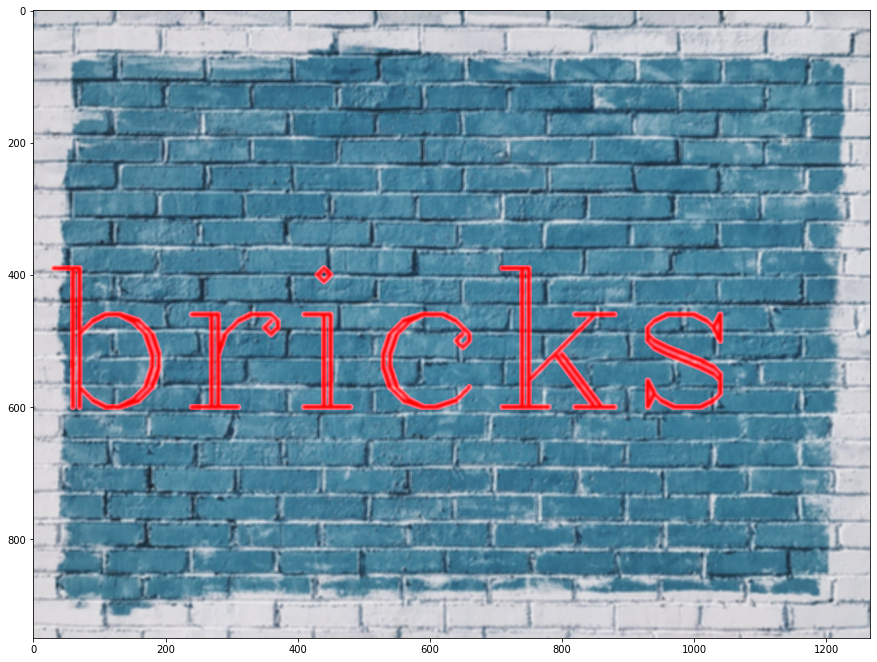

In [32]:
gaussian = cv2.GaussianBlur(img, (5,5),10)
show_pic(gaussian)

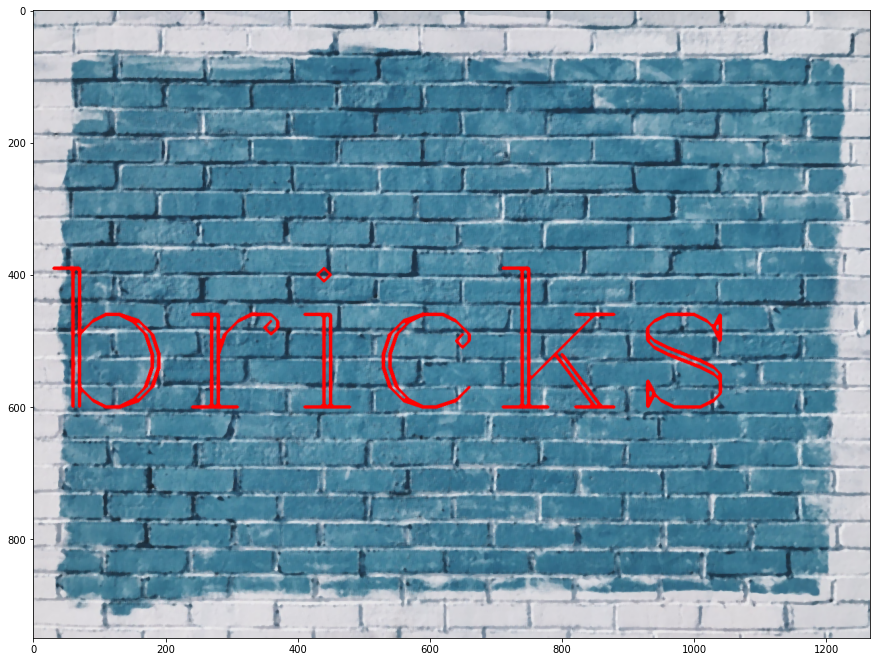

In [33]:
median = cv2.medianBlur(img,5)
show_pic(median)

In [34]:
img = cv2.imread('/content/drive/MyDrive/udemy/Computer-Vision-with-Python/DATA/sammy.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

noise_img = cv2.imread('/content/drive/MyDrive/udemy/Computer-Vision-with-Python/DATA/sammy_noise.jpg')

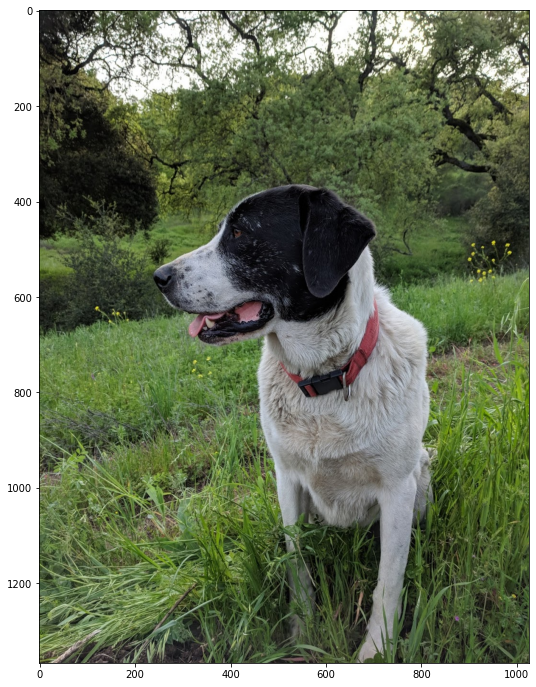

In [35]:
plt.figure(figsize=(10,12))
plt.imshow(img)

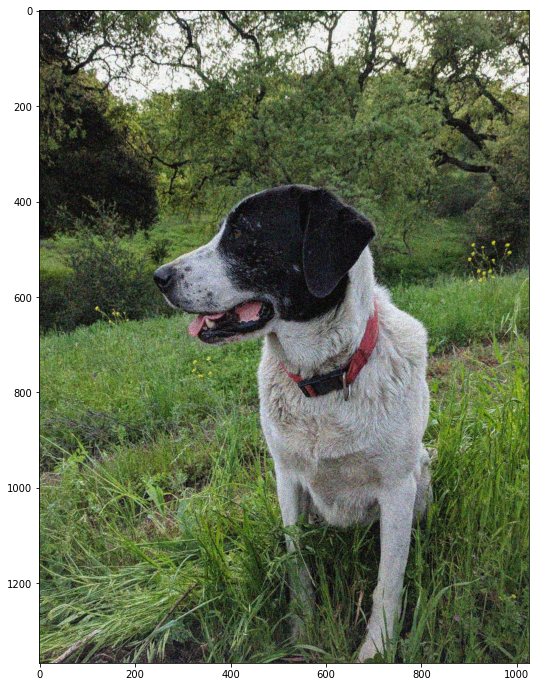

In [36]:
plt.figure(figsize=(10,12))
plt.imshow(noise_img)

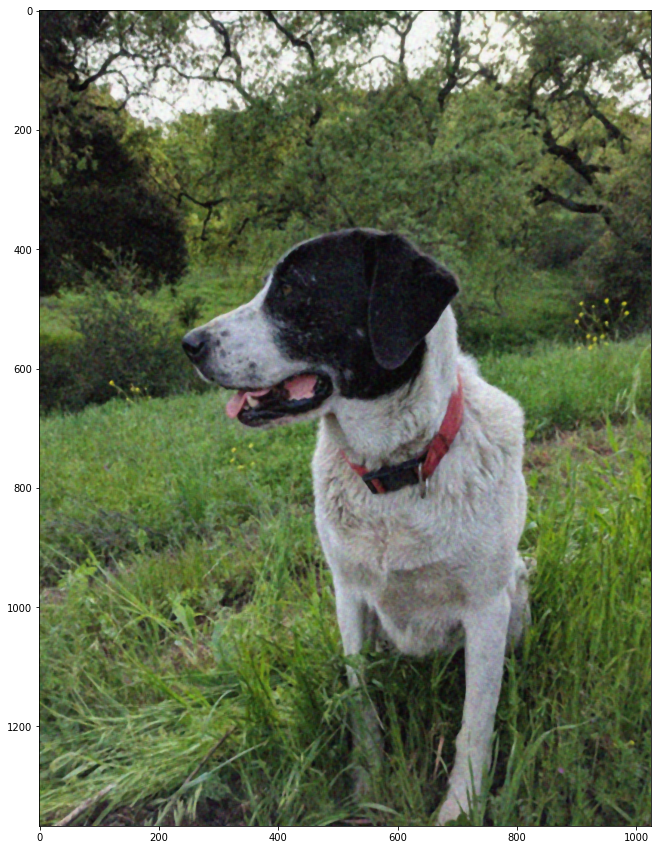

In [37]:
median = cv2.medianBlur(noise_img, 5)
show_pic(median)

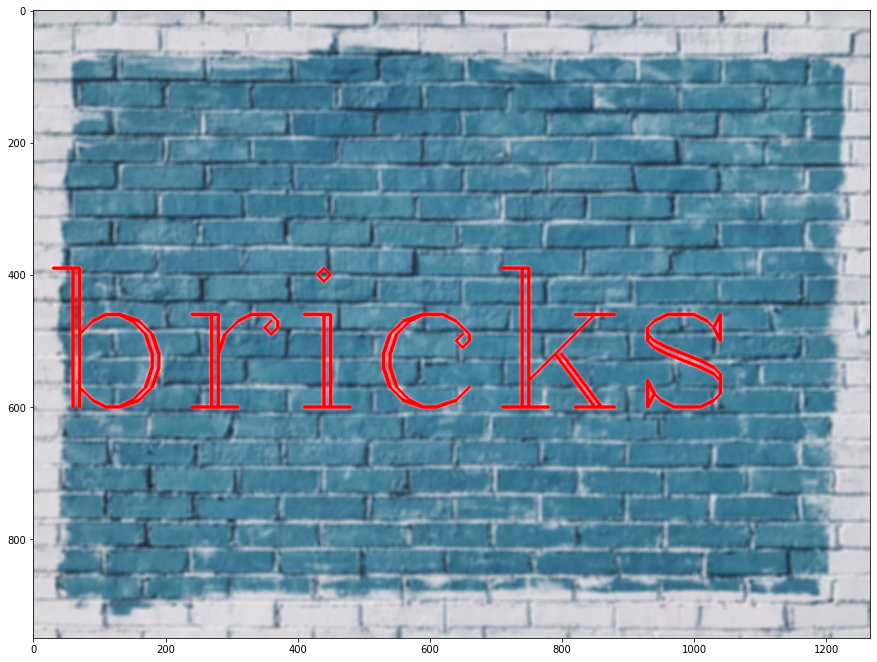

In [38]:
img = add_text()
blur = cv2.bilateralFilter(img,9,75,75)
show_pic(blur)

In [39]:
def load_plain_img():
    img = np.zeros((600,600))
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(img, text='ABCDE',org=(50,300),fontFace=font,fontScale=5,color=(255,255,255), thickness=40)
    return img

In [40]:
img = load_plain_img()

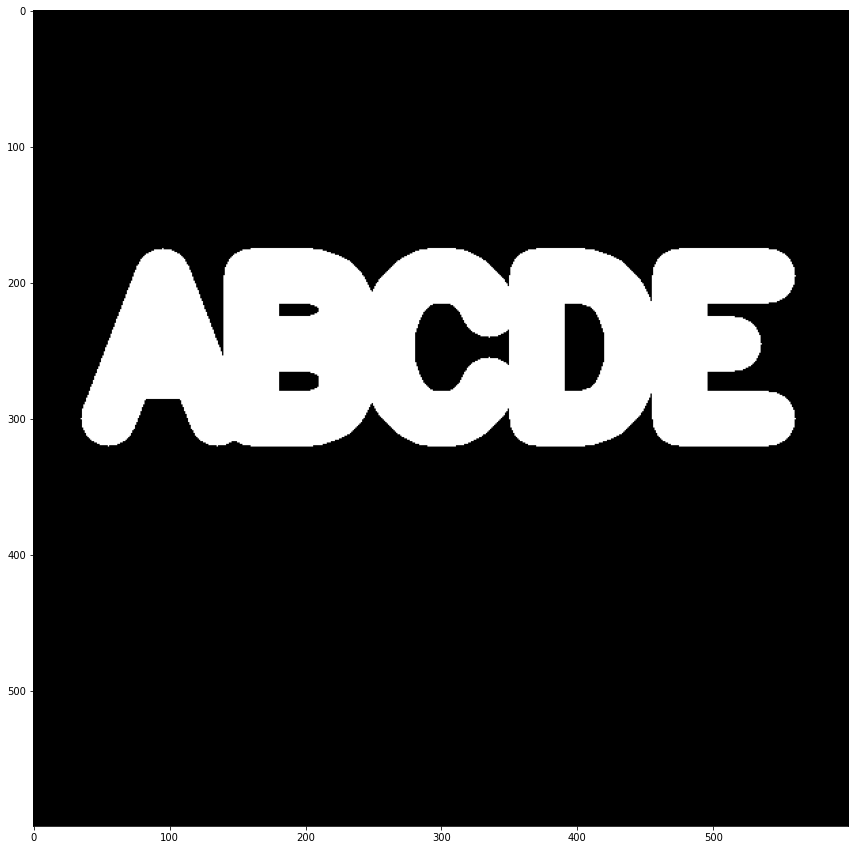

In [41]:
show_pic(img)

### Morphological Operators

* Erosion => Erodes edges
* Opening => Remove noise, specifically background noise, Erodes, then dilates
* Closing => Remove noise, foreground
* Morphological Gradient => Difference between Erosion and Dilation

In [42]:
kernel = np.ones((5,5), dtype=np.uint8)

In [43]:
result = cv2.erode(img, kernel, iterations=5)

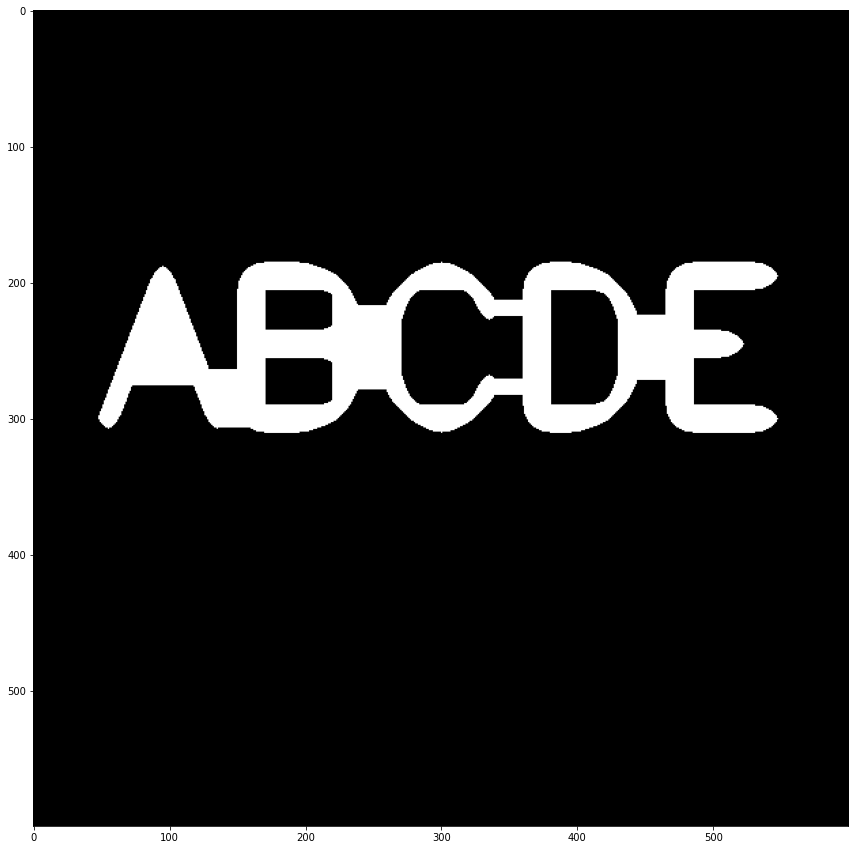

In [44]:
show_pic(result)

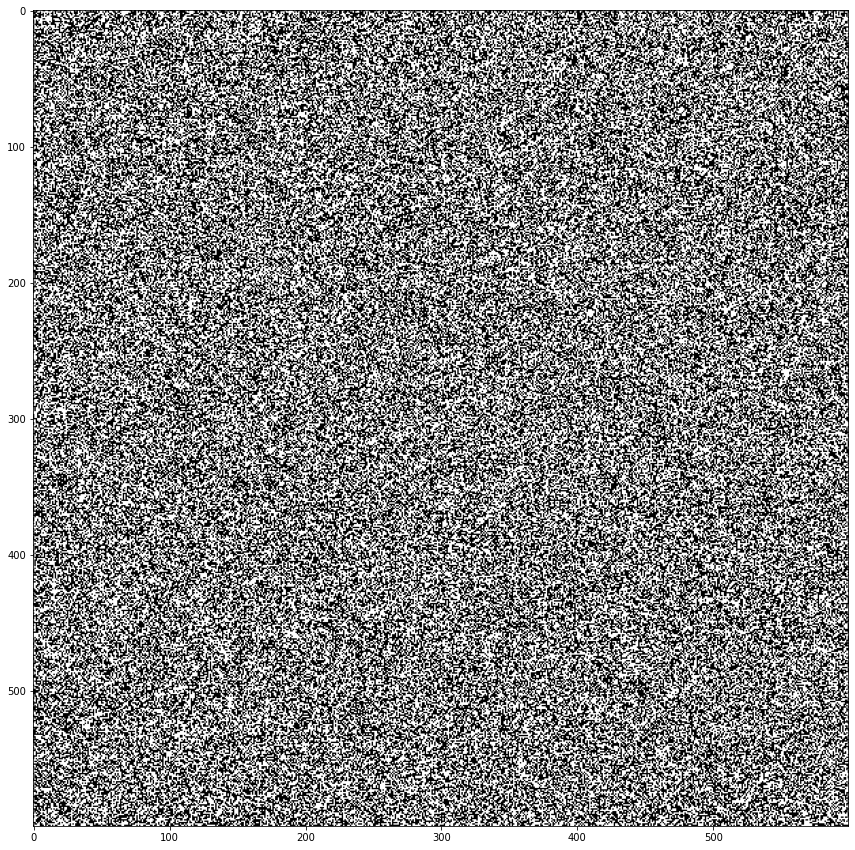

In [45]:
img = load_plain_img()
white_noise = np.random.randint(0,2,size=(600,600))
show_pic(white_noise)

In [46]:
white_noise = white_noise * 255 # Scale up to original image

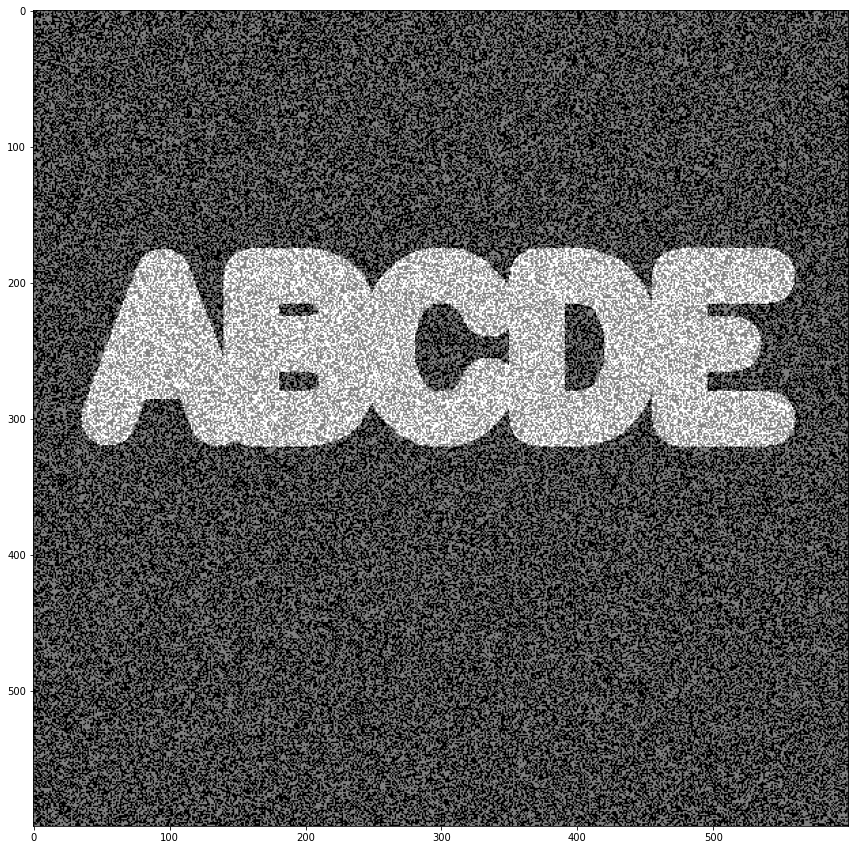

In [47]:
noise_img = img + white_noise
show_pic(noise_img)

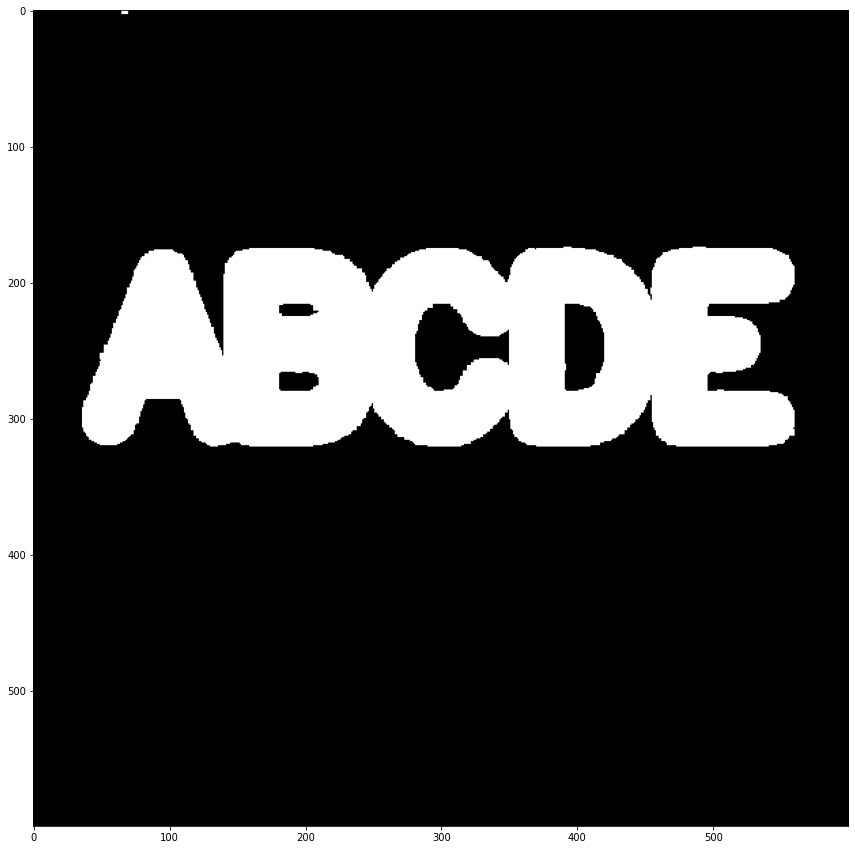

In [48]:
opening = cv2.morphologyEx(noise_img, cv2.MORPH_OPEN, kernel)
show_pic(opening)

In [49]:
img = load_plain_img()
black_noise = np.random.randint(0,2,size=(600,600))
black_noise = black_noise * -255 

In [50]:
black_noise_img = black_noise + img

In [51]:
black_noise_img[black_noise_img == -255] = 0

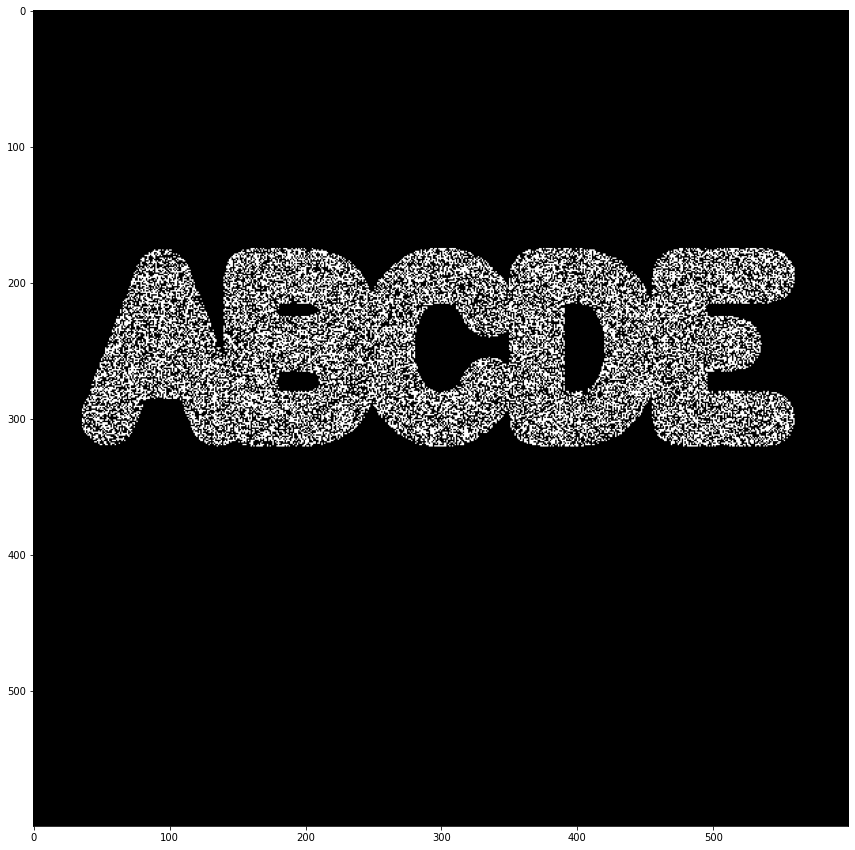

In [52]:
show_pic(black_noise_img)

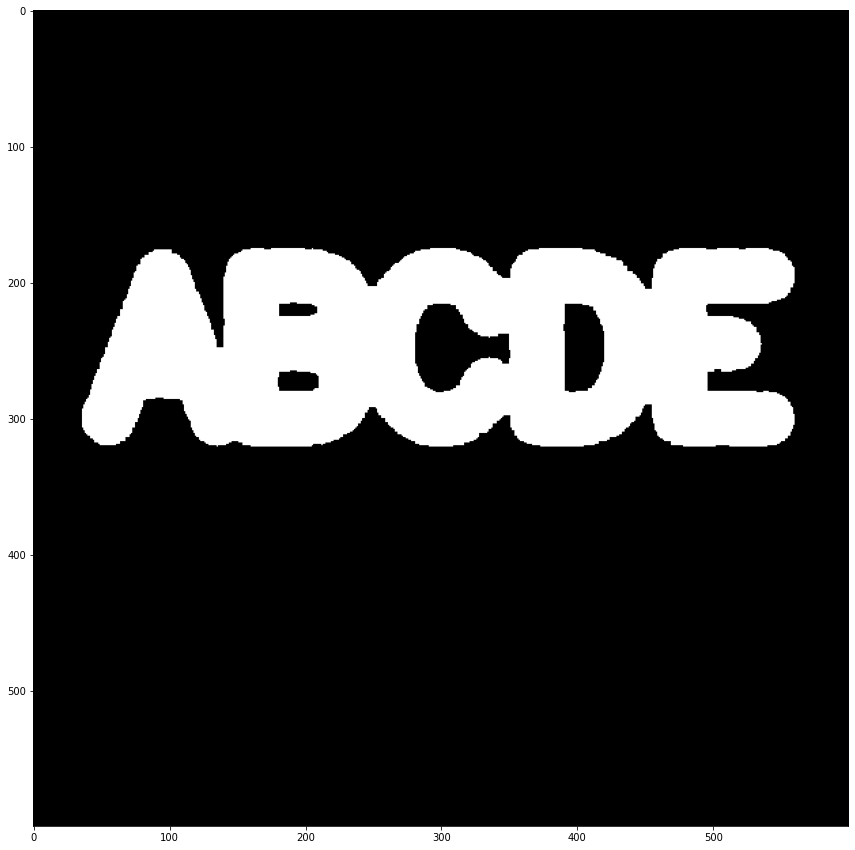

In [53]:
closing = cv2.morphologyEx(black_noise_img, cv2.MORPH_CLOSE, kernel)
show_pic(closing)

In [54]:
img = load_plain_img()

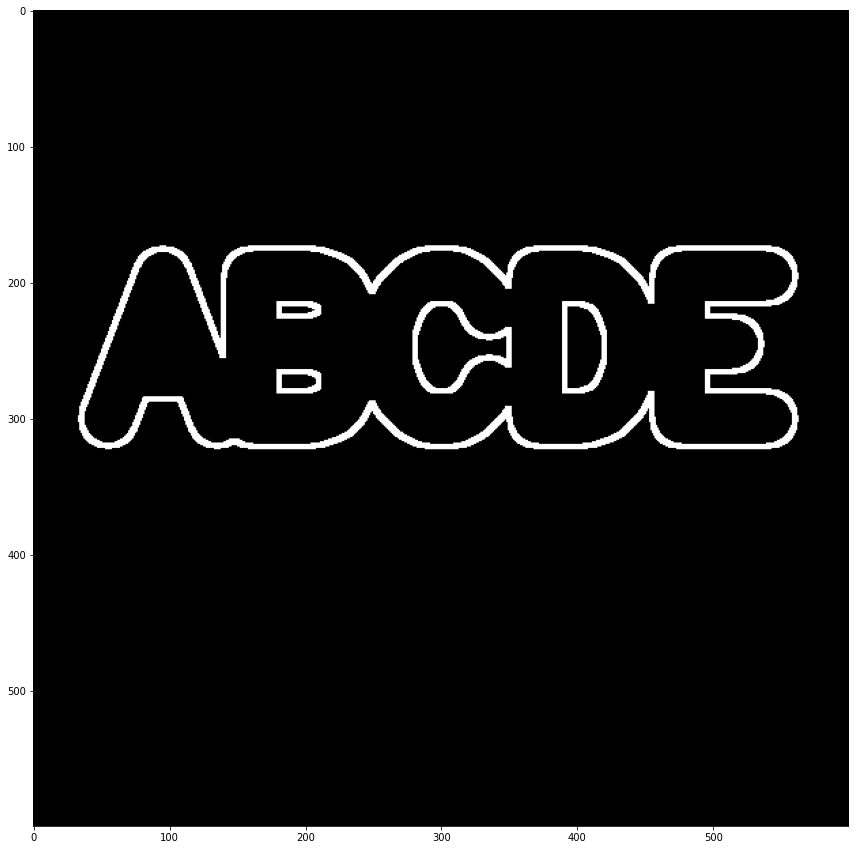

In [55]:
gradient = cv2.morphologyEx(img, cv2.MORPH_GRADIENT, kernel)
show_pic(gradient)

## Gradients

Directional Change in the intensity or color in an image

**Gradient Calculation with Sobel Operator**

* Normalized x-gradient, fades all horizontal lines, leaving vertical edges
* Normalized y-gradient, fades all vertical lines, leaving horizontal edges
* Normalized gradient magnitude: both

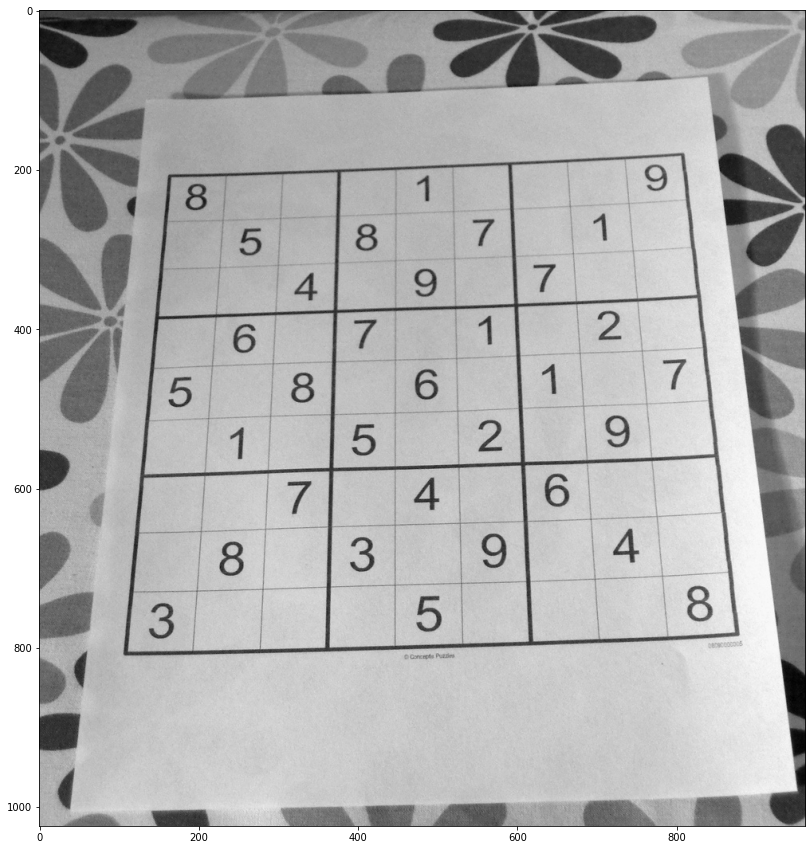

In [56]:
img = cv2.imread('/content/drive/MyDrive/udemy/Computer-Vision-with-Python/DATA/sudoku.jpg',0)
show_pic(img)

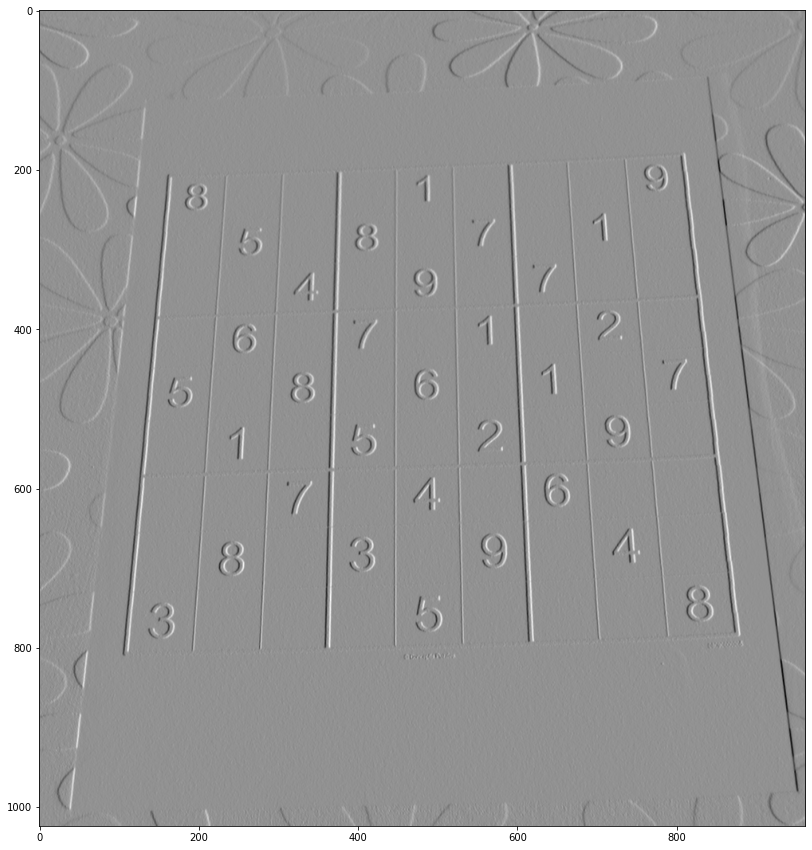

In [57]:
# x-gradient

sobelx = cv2.Sobel(img,cv2.CV_64F,dx=1,dy=0)
show_pic(sobelx)

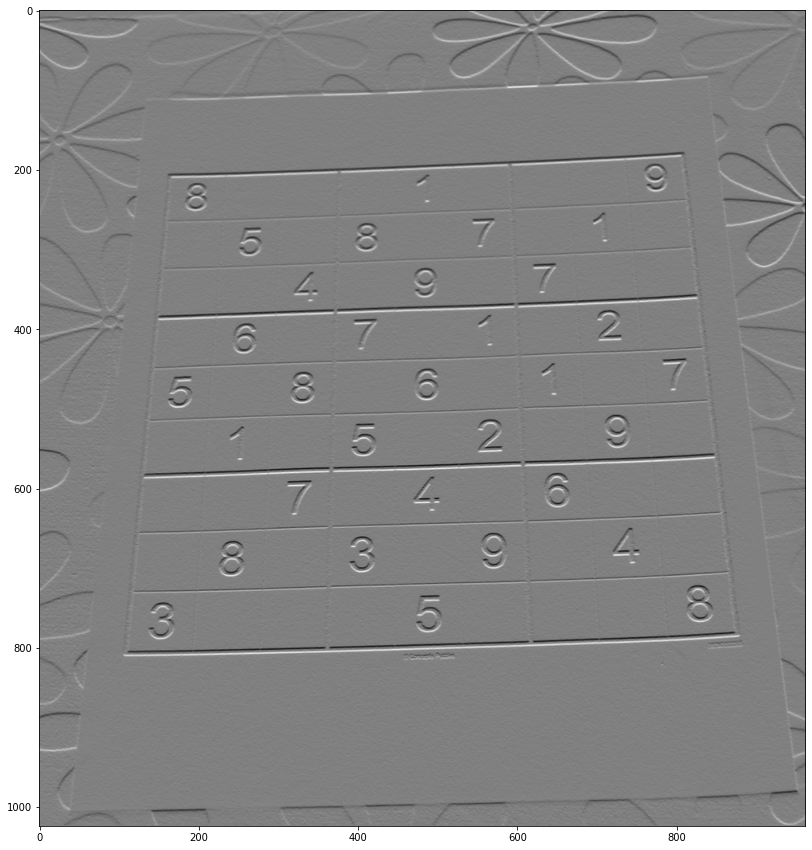

In [58]:
# y-gradient

sobely = cv2.Sobel(img,ddepth=cv2.CV_64F,dx=0,dy=1)
show_pic(sobely)

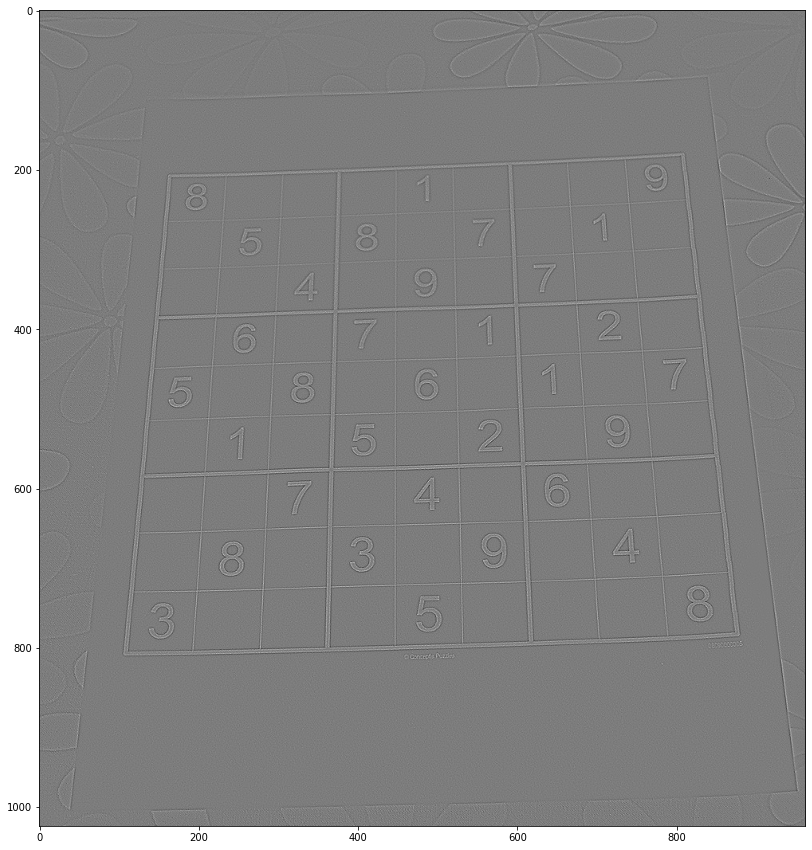

In [59]:
laplacian = cv2.Laplacian(img, cv2.CV_64F)
show_pic(laplacian)

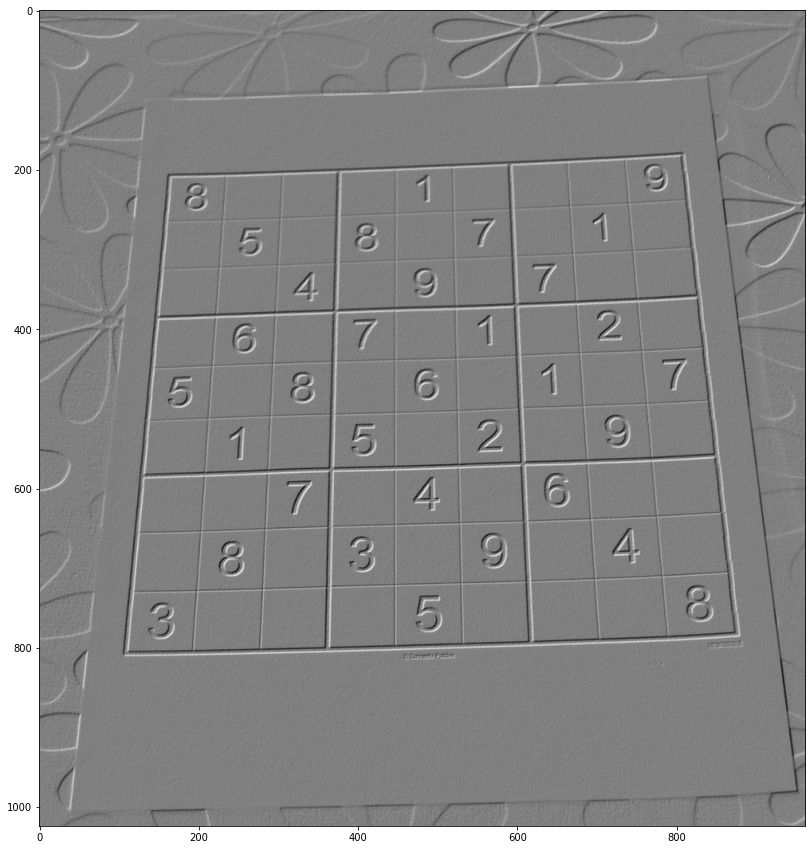

In [60]:
# Combined effect of x gradient and y gradient

blended = cv2.addWeighted(src1=sobelx, alpha=0.5, src2=sobely, beta=0.5, gamma=0)
show_pic(blended)

In [68]:
# threshold

ret, th1 = cv2.threshold(img,110,255,cv2.THRESH_BINARY)
ret

110.0

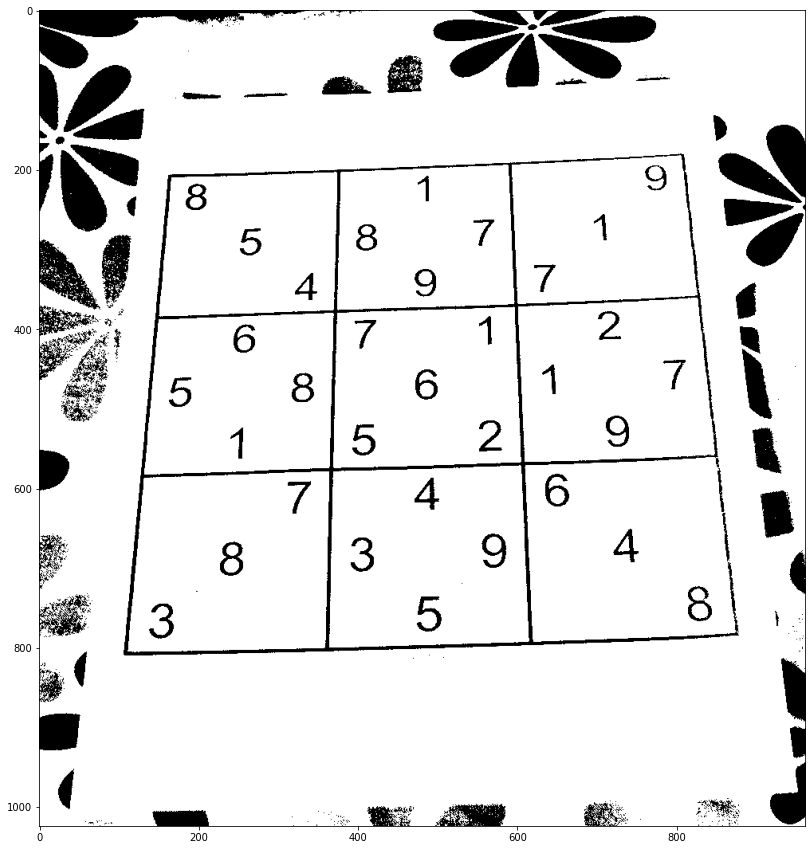

In [69]:
show_pic(th1)